# City of Chicago Crime Data (Jan.-Aug. 2020)
## Importing the crime data from City of Chicago API

In [1]:
import pandas as pd
import requests
import matplotlib.pyplot as plt
import scipy.stats as stats
import gmaps
from api_keys import g_key
from sodapy import Socrata

client = Socrata("data.cityofchicago.org", 'oZ8EJRNSGGQhBw5sNXjsHT2Nu')

client.timeout = 20
results = client.get("ijzp-q8t2", limit = 400000)

# Convert to pandas DataFrame
chicrimedf = pd.DataFrame(results)

## Cleaning the data and filtering by domestic crimes

In [2]:
# chicrimedf[['date','time']] = chicrimedf['date'].str.split(' ',expand=True)
chicrimedf['Dates'] = pd.to_datetime(chicrimedf['date']).dt.date
chicrimedf['Dates'] = pd.to_datetime(chicrimedf['Dates']) 
#subset data by primary-type violations
chicrimedf = chicrimedf[(chicrimedf["domestic"] == True)]
chicrimedf = chicrimedf[(chicrimedf["primary_type"] == "ASSAULT") | 
                        (chicrimedf["primary_type"] == "BATTERY") |
                        (chicrimedf["primary_type"] == "CONCEALED CARRY LICENSE VIOLATION") |
                        (chicrimedf["primary_type"] == "CRIM SEXUAL ASSAULT") |
                        (chicrimedf["primary_type"] == "HOMICIDE") | 
                        (chicrimedf["primary_type"] == "INTIMIDATION") |
                        (chicrimedf["primary_type"] == "NON-CRIMINAL") | 
                        (chicrimedf["primary_type"] == "OFFENSE INVOLVING CHILDREN") |
                        (chicrimedf["primary_type"] == "OTHER OFFENSE")]

chicrimedf.head()

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,location,:@computed_region_awaf_s7ux,:@computed_region_6mkv_f3dw,:@computed_region_vrxf_vc4k,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,:@computed_region_rpca_8um6,:@computed_region_d9mm_jgwp,:@computed_region_d3ds_rm58,Dates
2,12553894,JE460859,2021-11-29T23:45:00.000,090XX S ABERDEEN ST,0560,ASSAULT,SIMPLE,RESIDENCE,False,True,...,"{'latitude': '41.729651321', 'longitude': '-87...",18,21554,72,151,13,59,9,244,2021-11-29
17,12554235,JE461221,2021-11-29T23:05:00.000,124XX S EGGLESTON AVE,0498,BATTERY,"AGG. DOMESTIC BATTERY - HANDS, FISTS, FEET, SE...",RESIDENCE - YARD (FRONT / BACK),False,True,...,"{'latitude': '41.668083622', 'longitude': '-87...",45,21861,50,7,22,19,10,218,2021-11-29
29,12553833,JE460819,2021-11-29T22:26:00.000,070XX N RIDGE BLVD,0486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,True,True,...,"{'latitude': '42.00963196', 'longitude': '-87....",3,22528,10,268,5,12,11,33,2021-11-29
32,12553807,JE460809,2021-11-29T22:17:00.000,053XX W WASHINGTON BLVD,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,"{'latitude': '41.882319359', 'longitude': '-87...",11,22216,26,674,23,32,25,84,2021-11-29
34,12553828,JE460815,2021-11-29T22:15:00.000,006XX E 32ND ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,False,True,...,"{'latitude': '41.836085835', 'longitude': '-87...",1,21194,1,581,10,40,24,169,2021-11-29


## Reducing the dataset to pre-lockdown, lockdown, and post-lockdown increments

In [3]:
#Jan10-Mar19, Mar20-May28, May29-Aug5 2020
pretopostdf = chicrimedf[(chicrimedf['Dates'] >= '2020-01-10') & (chicrimedf['Dates'] <= '2020-08-05')]
predf = pretopostdf[(pretopostdf['Dates'] >= '2020-01-10') & (pretopostdf['Dates'] <= '2020-03-19')]
lockdowndf = pretopostdf[(pretopostdf['Dates'] >= '2020-03-20') & (pretopostdf['Dates'] <= '2020-05-28')]
postdf = pretopostdf[(pretopostdf['Dates'] >= '2020-05-29') & (pretopostdf['Dates'] <= '2020-08-05')]
pre = predf.count()[1]
lock = lockdowndf.count()[1]
post = postdf.count()[1]

prepostct = pretopostdf.groupby('Dates').count()['id']
prepostct = pd.DataFrame(prepostct)
prepostct['7day_ave'] = prepostct.id.rolling(7).mean().shift(-3)
prepostct = prepostct.reset_index()

In [5]:
pretopostdf

,id,case_number,date,block,iucr,primary_type,description,location_description,arrest,domestic,...,location,:@computed_region_awaf_s7ux,:@computed_region_6mkv_f3dw,:@computed_region_vrxf_vc4k,:@computed_region_bdys_3d7i,:@computed_region_43wa_7qmu,:@computed_region_rpca_8um6,:@computed_region_d9mm_jgwp,:@computed_region_d3ds_rm58,Dates
272821,12127092,JD322276,2020-08-05T23:20:00.000,017XX E 77TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE,True,True,...,"{'latitude': '41.755157236', 'longitude': '-87...",9,22538,39,188,35,24,19,222,2020-08-05
272834,12127631,JD322929,2020-08-05T22:30:00.000,031XX W FILLMORE ST,0560,ASSAULT,SIMPLE,APARTMENT,True,True,...,"{'latitude': '41.868242384', 'longitude': '-87...",36,21184,30,35,14,28,16,140,2020-08-05
272836,12127059,JD322261,2020-08-05T22:30:00.000,005XX S CENTRAL AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,RESIDENCE - PORCH / HALLWAY,False,True,...,"{'latitude': '41.873567157', 'longitude': '-87...",52,22216,26,68,7,32,25,97,2020-08-05
272840,12133932,JD322232,2020-08-05T22:15:00.000,012XX S ST LOUIS AVE,0486,BATTERY,DOMESTIC BATTERY SIMPLE,SIDEWALK,False,True,...,"{'latitude': '41.866030297', 'longitude': '-87...",36,21572,30,772,14,57,21,153,2020-08-05
272865,12127598,JD322238,2020-08-05T21:38:00.000,014XX N SEDGWICK ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,OTHER (SPECIFY),False,True,...,"{'latitude': '41.908430535', 'longitude': '-87...",41,14926,37,309,46,54,14,198,2020-08-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
391936,11947642,JD110502,2020-01-10T01:00:00.000,072XX S ROCKWELL ST,1710,OFFENSE INVOLVING CHILDREN,ENDANGERING LIFE/HEALTH CHILD,RESIDENCE,False,True,...,"{'latitude': '41.762041346', 'longitude': '-87...",6,21867,64,333,30,58,13,208,2020-01-10
391943,11947201,JD110432,2020-01-10T00:27:00.000,001XX E 111TH ST,0486,BATTERY,DOMESTIC BATTERY SIMPLE,VEHICLE NON-COMMERCIAL,True,True,...,"{'latitude': '41.692604495', 'longitude': '-87...",30,21861,45,253,43,19,10,265,2020-01-10
391950,11954352,JD119097,2020-01-10T00:01:00.000,048XX S HARDING AVE,2820,OTHER OFFENSE,TELEPHONE THREAT,RESIDENCE,False,True,...,"{'latitude': '41.805278163', 'longitude': '-87...",49,22248,54,698,8,56,13,103,2020-01-10
391953,11954158,JD118344,2020-01-10T00:01:00.000,045XX S PAULINA ST,1752,OFFENSE INVOLVING CHILDREN,AGG CRIM SEX ABUSE FAM MEMBER,RESIDENCE,False,True,...,"{'latitude': '41.811373283', 'longitude': '-87...",53,14924,59,738,3,37,23,108,2020-01-10


## Creating a 7-day moving average time series plot of number of crimes divided into three equal periods around lockdown

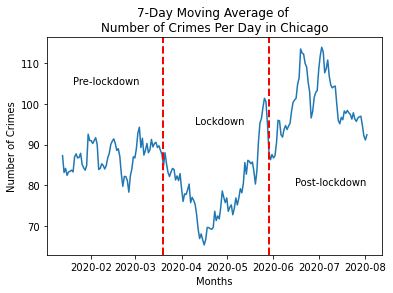

In [209]:
x = prepostct["Dates"]
y = prepostct["7day_ave"]
plt.plot(x,y)
plt.title("7-Day Moving Average of \nNumber of Crimes Per Day in Chicago")
plt.xlabel("Months")
plt.ylabel("Number of Crimes")
plt.axvline(pd.to_datetime('2020-03-20'), color='r', linestyle='--', lw=2)
plt.axvline(pd.to_datetime('2020-05-29'), color='r', linestyle='--', lw=2)
plt.text(pd.to_datetime("2020-01-20"), 105, "Pre-lockdown")
plt.text(pd.to_datetime("2020-04-10"), 95, "Lockdown")
plt.text(pd.to_datetime("2020-06-15"), 80, "Post-lockdown")
plt.savefig('7dayavgnumcrimes.png', dpi = 350);

## A goodness of fit chi-square to evaluate whether number of crimes over three equal periods was the same

* $H_0$: There is no difference in levels of crime between the three equal periods (i.e., levels of crime did not rise or fall depending on the time period)

* $H_A$: During lockdown domestic crimes were higher than pre- or post-lockdown. 

* Finding: There is significant variation between the three periods (*p* < 0.001); however, the finding was in the opposite direction than hypothesized, where lockdown crime counts were the lowest compared to pre- and post-lockdown crime counts. 

In [86]:
observed = pd.Series([pre,lock,post], index=["Pre-lockdown", "Lockdown", "Post-Lockdown"])
df = pd.DataFrame([observed]).T
df[1] = (pre + lock + post)/3
df.columns = ["observed", "expected"]
stats.chisquare(df['observed'], df['expected'])

Power_divergenceResult(statistic=136.9717807330522, pvalue=1.8069899019433304e-30)

## A heatmap of crime counts overall across Jan.-Aug. 2020 period

In [184]:
gmaps.configure(api_key=g_key)
pretopostdf = pretopostdf.dropna()
num = pretopostdf['id'].astype(float)
lat = pretopostdf['latitude'].astype(float)
lat = round(lat, 2)
long = pretopostdf['longitude'].astype(float)
long = round(long, 2)
data = zip(num, lat, long)
data = pd.DataFrame(data, columns = ['id', 'lat', 'long'])
locations = data.groupby(['lat', 'long']).count().reset_index().astype(float)[['lat', 'long']]
count = data.groupby(['lat', 'long']).count().reset_index().astype(float)['id']
fig = gmaps.figure(center=(41.9, -87.5),zoom_level=9.5, map_type = 'HYBRID')

heat_layer = gmaps.heatmap_layer(locations, weights=count, 
                                 dissipating=False, max_intensity=1,
                                 point_radius = 0.005)
fig.add_layer(heat_layer)
fig

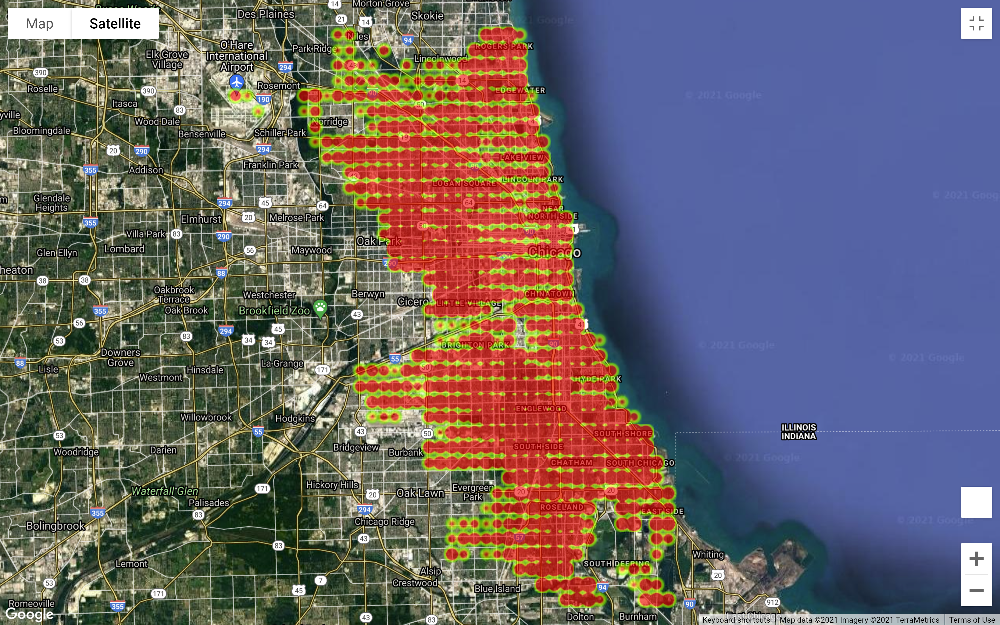

In [246]:
from IPython.display import Image
Image(filename='chiheatmapzoomed.png')

## A bar graph of different categories of domestic crime committed during lockdown

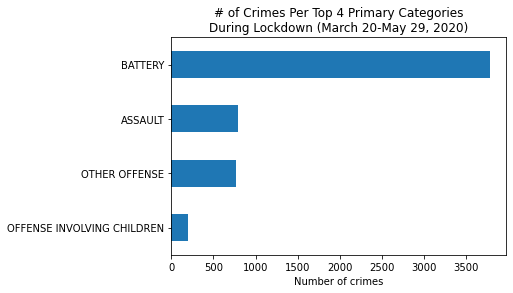

In [245]:
lktype = lockdowndf.groupby('primary_type').count().reset_index()
x = lockdowndf.groupby('primary_type')['id'].count().sort_values().tail(4)
x.plot(kind = 'barh')
plt.title("# of Crimes Per Top 4 Primary Categories\nDuring Lockdown (March 20-May 29, 2020)")
plt.xlabel("Number of crimes")
plt.ylabel("")
plt.savefig("crimes4cat.png", dpi = 350);